In [1]:
from IPython.display import Video, display, clear_output

In [2]:
Video("pendulito.mp4", embed=True, width=640, height=360)

## Obtención del video

In [3]:
import cv2
import numpy as np
from tqdm.notebook import tqdm
from IPython.display import clear_output, display
import matplotlib.pyplot as plt

In [4]:
def to_hsv(frame):
    return cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

def reduce_noise(channel):
    kernel = np.ones((3, 3), np.uint8)
    return cv2.morphologyEx(channel, cv2.MORPH_OPEN, kernel)

def threshold_hsv(hsv_frame):

    # --- Rango 1: Azul brillante ---
    lower_bright = np.array([100, 150, 100])
    upper_bright = np.array([130, 255, 255])

    # --- Rango 2: Azul muy oscuro ---
    lower_dark = np.array([100, 100, 30])
    upper_dark = np.array([130, 255, 90])

    mask_bright = cv2.inRange(hsv_frame, lower_bright, upper_bright)
    mask_dark = cv2.inRange(hsv_frame, lower_dark, upper_dark)

    combined_mask = cv2.bitwise_or(mask_bright, mask_dark)

    kernel = np.ones((3, 3), np.uint8)
    mask_dilated = cv2.dilate(combined_mask, kernel, iterations=20)
    mask_eroded = cv2.erode(mask_dilated, kernel, iterations=15)

    return mask_eroded


def find_largest_contour(binary_frame, min_area=100):
    contours, _ = cv2.findContours(binary_frame, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    filtered = [cnt for cnt in contours if cv2.contourArea(cnt) > min_area]
    return max(filtered, key=cv2.contourArea) if filtered else None


def compute_centroid(contour):
    M = cv2.moments(contour)
    if M["m00"] != 0:
        return int(M["m10"] / M["m00"]), int(M["m01"] / M["m00"])
    return None

def draw_centroid(frame, centroid):
    if centroid:
        cv2.circle(frame, centroid, 5, (0, 0, 255), -1)
    return frame

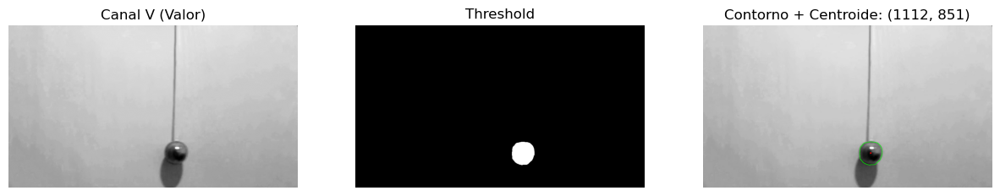

In [ ]:
frame_id = 358
cap = cv2.VideoCapture("pendulito.mp4")
cap.set(cv2.CAP_PROP_POS_FRAMES, frame_id)
ret, frame = cap.read()
cap.release()

if not ret:
    print("No se pudo leer el frame.")
else:
    hsv = to_hsv(frame)
    cleaned = reduce_noise(hsv[:, :, 2])  # Solo el canal V

    binary = threshold_hsv(hsv)

    # Cierre extra opcional
    kernel = np.ones((3, 3), np.uint8)
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel, iterations=2)

    contour = find_largest_contour(binary, min_area=50)
    centroid = compute_centroid(contour) if contour is not None else None

    # Mostrar resultados
    debug_frame = cv2.cvtColor(cleaned, cv2.COLOR_GRAY2BGR)
    if contour is not None:
        cv2.drawContours(debug_frame, [contour], -1, (0, 255, 0), 2)
    debug_frame = draw_centroid(debug_frame, centroid)

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    axs[0].imshow(hsv[:, :, 2], cmap='gray'); axs[0].set_title('Canal V (Valor)')
    axs[1].imshow(binary, cmap='gray'); axs[1].set_title('Threshold')
    axs[2].imshow(cv2.cvtColor(debug_frame, cv2.COLOR_BGR2RGB)); axs[2].set_title(f'Contorno + Centroide: {centroid}')
    for ax in axs: ax.axis('off')
    plt.show()

##### Algunas medidas útiles

In [6]:
# 0.38 m es la longitud del péndulo visible (0.46 en total)
# La proporción entre la longitud del péndulo y la distancia al centroide
scale = 0.37 / centroid[1]
pendulum_lenght = 0.52 # Longitud total del péndulo
print(f"Longitud del péndulo: {pendulum_lenght} m")
print(f"Proporción entre la longitud visible del péndulo y la distancia al centroide (metros que hay en un pixel): {scale}")

Longitud del péndulo: 0.52 m
Proporción entre la longitud visible del péndulo y la distancia al centroide (metros que hay en un pixel): 0.0004347826086956522


In [7]:
import seaborn as sns
import pandas as pd

In [8]:
centroids = []

cap = cv2.VideoCapture("pendulito.mp4")
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

for frame_id in tqdm(range(total_frames)):
    ret, frame = cap.read()
    if not ret:
        centroids.append(None)
        continue

    hsv = to_hsv(frame)
    binary = threshold_hsv(hsv)

    contour = find_largest_contour(binary, min_area=100)
    centroid = compute_centroid(contour) if contour is not None else None

    centroids.append(centroid)

cap.release()

  0%|          | 0/903 [00:00<?, ?it/s]

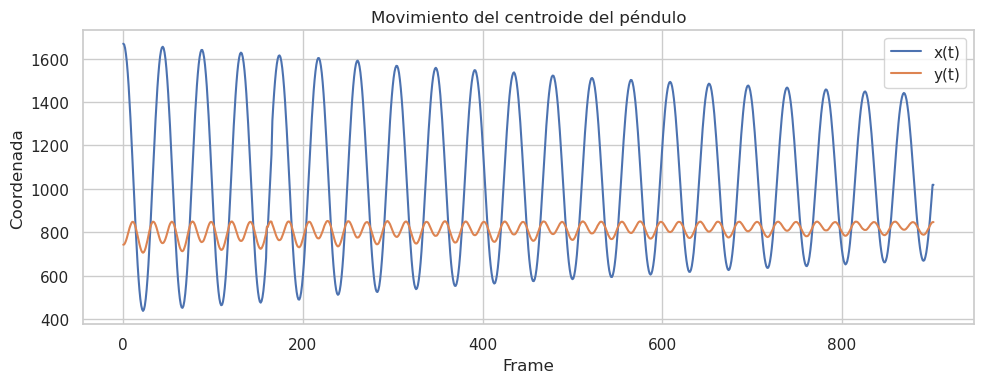

In [9]:
x_vals = [c[0] if c else None for c in centroids]
y_vals = [c[1] if c else None for c in centroids]
t_vals = list(range(len(centroids)))

df = pd.DataFrame({
    'Frame': t_vals,
    'x(t)': x_vals,
    'y(t)': y_vals
})

# Estilo de Seaborn
sns.set_theme(style="whitegrid")

plt.figure(figsize=(10, 4))
sns.lineplot(data=df[['Frame', 'x(t)']].dropna(), x='Frame', y='x(t)', label='x(t)')
sns.lineplot(data=df[['Frame', 'y(t)']].dropna(), x='Frame', y='y(t)', label='y(t)')

plt.xlabel('Frame')
plt.ylabel('Coordenada')
plt.title('Movimiento del centroide del péndulo')
plt.legend()
plt.tight_layout()
plt.show()


## 4- Análisis de movimiento    

### 4.1 Cálculo de la posición angular   


#### Obtención de fps y diferencial de tiempo dt

In [10]:
g = 9.81  # aceleración de la gravedad 

In [11]:
# 1. Obtener fps y dt
cap = cv2.VideoCapture("pendulito.mp4")
fps = cap.get(cv2.CAP_PROP_FPS)
cap.release()

# Si no se leyó bien el fps
if fps is None or fps <= 0:
    print("⚠️ No se pudo leer el FPS; usando valor por defecto de 30 fps")
    fps = 30.0

dt = 1.0 / fps
print(f"Usando dt = {dt:.4f} s por frame")

Usando dt = 0.0333 s por frame


In [12]:
# 1. Añadir columnas en metros
df['x (m)'] = df['x(t)'] * scale
df['y (m)'] = df['y(t)'] * scale

pivot_px = (1112, -345.5)

# Desplazamientos relativos en metros
df['dx (m)'] = (df['x(t)'] - pivot_px[0]) * scale
df['dy (m)'] = (df['y(t)'] - pivot_px[1]) * scale

# Ángulo real θ en radianes
df['theta (rad)'] = np.arctan2(df['dx (m)'], df['dy (m)'])

omega0 = np.sqrt(g / pendulum_lenght)
time = df['Frame'] * dt
theta0 = df['theta (rad)'].abs().max()   
df['theta teor pura'] = theta0 * np.cos(omega0 * time)
df['alpha teor pura'] = - omega0**2 * df['theta teor pura']

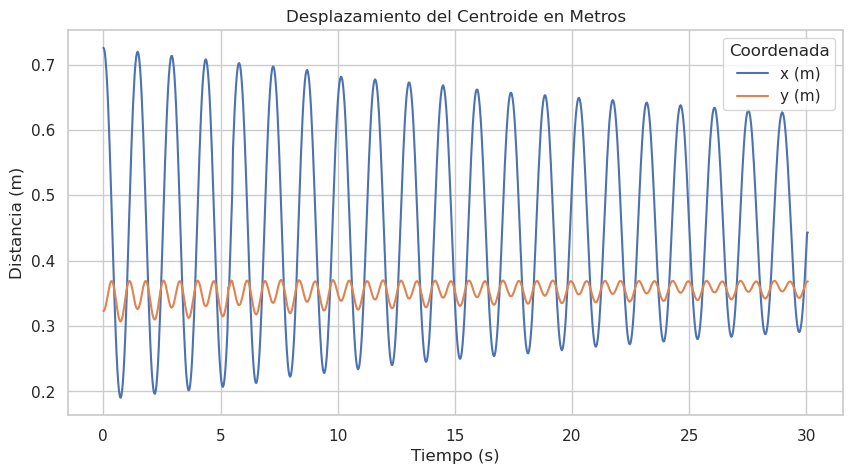

In [13]:
# 2. Graficar desplazamiento en metros
disp_df = df.melt(
    id_vars='Frame', 
    value_vars=['x (m)', 'y (m)'], 
    var_name='Coordenada', 
    value_name='Distancia (m)'
)
disp_df['Time (s)'] = disp_df['Frame'] * dt

plt.figure(figsize=(10, 5))
sns.lineplot(data=disp_df, x='Time (s)', y='Distancia (m)', hue='Coordenada')
plt.title('Desplazamiento del Centroide en Metros')
plt.xlabel('Tiempo (s)')
plt.ylabel('Distancia (m)')
plt.legend(title='Coordenada')
plt.show()

In [14]:
from scipy.signal import savgol_filter

In [15]:
# 2.b Limpiar outliers en θ
df['theta (rad)'] = df['theta (rad)'].interpolate(limit=2)
mask = df['theta (rad)'].diff().abs() > 0.3   # umbral de salto: 0.3 rad/frame
df.loc[mask, 'theta (rad)'] = np.nan
df['theta (rad)'] = df['theta (rad)'].interpolate(limit=2)

# 2.c Suavizar θ antes de derivar

df['theta_smooth'] = savgol_filter(df['theta (rad)'], window_length=11, polyorder=3, mode='interp')

# 2.d Recalcular ω y α experimental sobre θ_smooth
df['omega (rad/s)'] = np.gradient(df['theta_smooth'], dt)
df['alpha experimental (rad/s²)'] = np.gradient(df['omega (rad/s)'], dt)

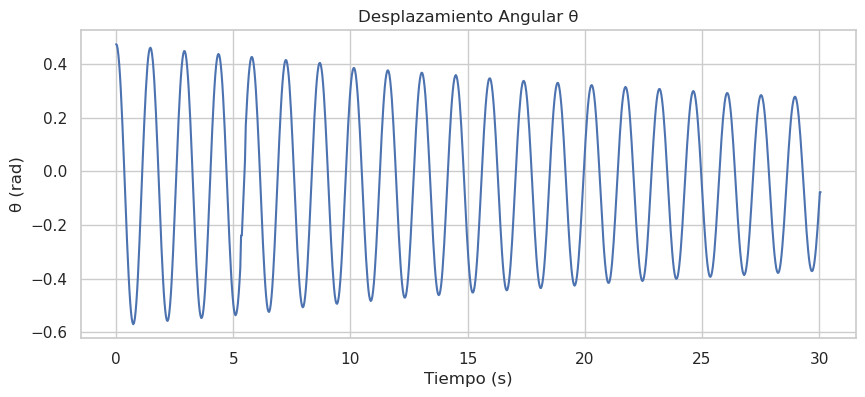

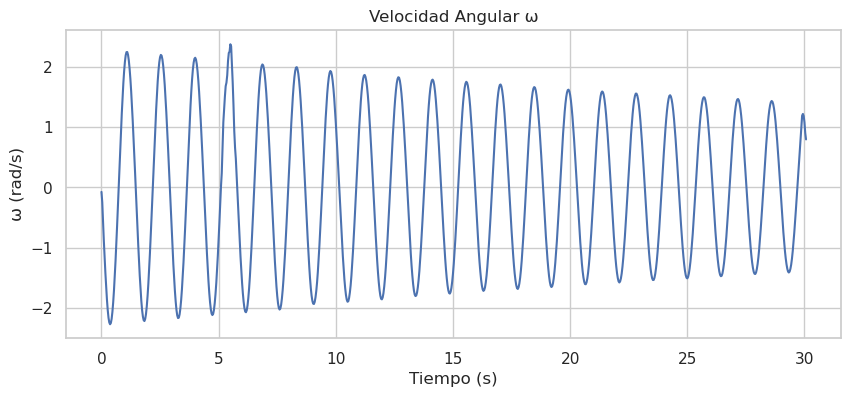

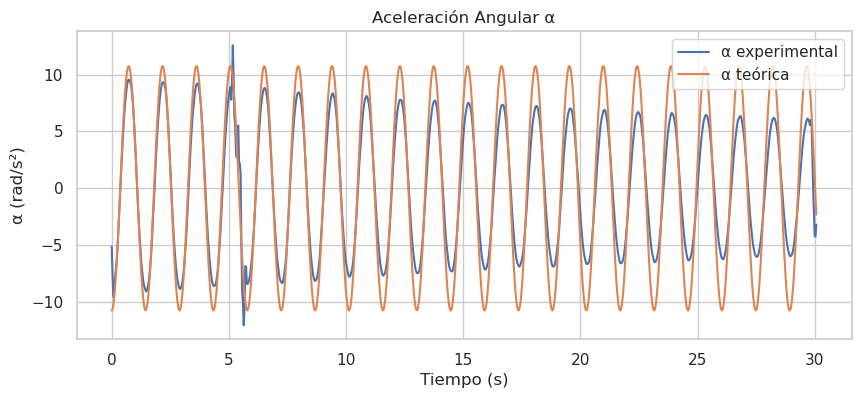

In [16]:
# 3. Graficar θ, ω y α
ang_df = df.copy()
ang_df['Time (s)'] = ang_df['Frame'] * dt

# θ
plt.figure(figsize=(10, 4))
sns.lineplot(data=ang_df, x='Time (s)', y='theta (rad)')
plt.title('Desplazamiento Angular θ')
plt.xlabel('Tiempo (s)')
plt.ylabel('θ (rad)')
plt.show()

# ω
plt.figure(figsize=(10, 4))
sns.lineplot(data=ang_df, x='Time (s)', y='omega (rad/s)')
plt.title('Velocidad Angular ω')
plt.xlabel('Tiempo (s)')
plt.ylabel('ω (rad/s)')
plt.show()

# α experimental vs. teórica
plt.figure(figsize=(10, 4))
sns.lineplot(data=ang_df, x='Time (s)', y='alpha experimental (rad/s²)', label='α experimental')
sns.lineplot(data=ang_df, x='Time (s)', y='alpha teor pura', label='α teórica')
plt.title('Aceleración Angular α')
plt.xlabel('Tiempo (s)')
plt.ylabel('α (rad/s²)')
plt.legend()
plt.show()
